# Trial flow fields

In [1]:
""" 
IMPORTS
"""
import os
import autograd.numpy as np
import pickle
import seaborn as sns
from collections import defaultdict
import pandas as pd
from scipy.ndimage import gaussian_filter1d
from scipy import stats
from datetime import datetime
from scipy.interpolate import interp1d

# --Machine learning and statistics+
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
import umap

from one.api import ONE
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.collections import LineCollection
from matplotlib.colors import BoundaryNorm, ListedColormap

# Get my functions
functions_path =  '/home/ines/repositories/representation_learning_variability/Functions/'
# functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/Functions/'
os.chdir(functions_path)
from plotting_functions import bins_per_trial_phase, broader_label
from data_processing import interpolate, group_per_phase, pca_behavior, plot_timeseries_pcs, augment_data
one = ONE(base_url='https://alyx.internationalbrainlab.org')

/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/one/api.py:1465: UserWarning: Newer cache tables require ONE version 2.7 or greater
  warnings.warn(f'Newer cache tables require ONE version {min_version} or greater')


## Parameters

In [2]:
bin_size = 0.1

data_path_v1 =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/' + 'v1/' + str(bin_size) + '/'
data_path_v2 =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/' + 'v2_3Nov2023/' + str(bin_size) + '/'
# data_path_v2 =  '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/' + 'v2_3Nov2023/' + str(bin_size) + '/'

data_path = data_path_v2

os.chdir(data_path)
design_matrices = os.listdir(data_path)

if data_path == data_path_v1:
       var_names = ['avg_wheel_vel', 'pupil_diameter',
              'whisker_me', 'nose_speed_X', 'nose_speed_Y', 
              'l_paw_speed_X', 'l_paw_speed_Y', 'pupil_speed_X',
              'pupil_speed_Y', 'Gaussian_licks']
elif data_path == data_path_v2:
       var_names = ['avg_wheel_vel', 'pupil_diameter',
              'whisker_me', 'nose_speed', 'l_paw_speed', 'left_X', 'left_Y',
              'pupil_speed', 'pupil_X', 'pupil_Y', 'Lick count']

# Plotting params
multiplier = 1/bin_size

event_type_list = ['goCueTrigger_times']  # , 'feedback_times', 'firstMovement_times'
event_type_name = ['Go cue']  # , 'Feedback time', 'First movement onset'

## Load data

In [3]:
need_to_compute = False

In [10]:
if need_to_compute:
    # Save data of all sessions for latter
    idxs = []
    mouse_names = []
    for m, mat in enumerate(design_matrices):
        
        mouse_name = design_matrices[m][51:-4]
        eid = design_matrices[m][14:50]
        idx = str(eid + '_' + mouse_name)
        if m == 0:
            idxs = idx
            mouse_names = mouse_name
        else:
            idxs = np.hstack((idxs, idx))
            mouse_names = np.hstack((mouse_names, mouse_name))
            
    # Save data of all sessions for latter
    matrix_all = defaultdict(list)
    matrix_all_unnorm = defaultdict(list)
    session_all = defaultdict(list)
    epoch_df = defaultdict(list)

    for m, mouse_name in enumerate(mouse_names):
        # Save results per mouse
        matrix_all[mouse_name] = {}
        session_all[mouse_name] = {}
        matrix_all_unnorm[mouse_name] = {}
        epoch_df[mouse_name] = {}
        
    for m, mat in enumerate(idxs):
        if len(mat) > 35: 
                
            # Trials data
            session = mat[0:36]
            mouse_name = mat[37:]

            session_trials = one.load_object(session, obj='trials', namespace='ibl')
            session_trials = session_trials.to_df()
            session_end = list(session_trials['stimOff_times'][-1:])[0]  # TODO: this might not work if stimOff times are missing
            session_start = list(session_trials['stimOn_times'])[0]

            # Get time of last unbiased trial
            unbiased = session_trials.loc[session_trials['probabilityLeft']==0.5]
            time_trial_90 = list(unbiased['stimOff_times'])[-1]
            
            filename = str('design_matrix_' + mat + '_'  + str(bin_size))  # + mouse_name + '_'
                    
            big_design_matrix = pickle.load(open(filename, "rb"))
            design_matrix = big_design_matrix.groupby('Bin')[var_names].mean()  # 
            design_matrix = design_matrix.reset_index(level = [0])  # , 'Onset times'
            design_matrix = design_matrix.dropna()
        
            # # Keep only first 90 trials
            # design_matrix = design_matrix.loc[(design_matrix['Bin'] < time_trial_90 * 10) & (design_matrix['Bin'] > session_start * 10)]
            # unbiased_trials = session_trials.loc[session_trials['stimOff_times'] < time_trial_90]
            # training_set = np.array(design_matrix[var_names]).copy() 

            # Keep all session
            design_matrix = design_matrix.loc[(design_matrix['Bin'] < session_end * 10) & (design_matrix['Bin'] > session_start * 10)]
            use_trials = session_trials.loc[session_trials['stimOff_times'] < session_end]
            training_set = np.array(design_matrix[var_names]).copy() 
            
            # Get trial epoch
            bins_df = bins_per_trial_phase(design_matrix, session_trials)
            bins_df = bins_df.rename(columns={0: 'Bin'})
            new_df = design_matrix.merge(bins_df, on='Bin')
            new_df = broader_label(new_df)
            
            if len(training_set) > 0:
                # Standardization using StandardScaler
                scaler = StandardScaler()
                standardized = scaler.fit_transform(training_set)
                # Normalize between 0 and 1
                normalizer = Normalizer().fit(standardized)
                normalized = normalizer.transform(standardized)
                
                matrix_all[mouse_name][session] = normalized
                session_all[mouse_name][session] = use_trials    
                matrix_all_unnorm[mouse_name][session] = design_matrix
                epoch_df[mouse_name][session] = new_df
                
            else:
                print(session)
        else:
            print(mat)


    # Get current date
    current_date = datetime.now()
    # Convert current date to string format
    date_string = current_date.strftime('%Y-%m-%d')  # Format: YYYY-MM-DD

    # Save data
    pickle.dump(matrix_all, open(str('matrix_all_'+ date_string), 'wb'))
    pickle.dump(session_all, open(str('session_all_'+date_string), 'wb'))
    pickle.dump(matrix_all_unnorm, open(str('matrix_all_unnorm_'+date_string), 'wb'))
    pickle.dump(epoch_df, open(str('epoch_df_'+date_string), 'wb'))

else:
    data_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/'
    # data_path =  '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/DATA/Sub-trial/Design matrix/'
    os.chdir(data_path)
    matrix_all = pickle.load(open('matrix_all_2024-04-04', 'rb'))
    session_all = pickle.load(open('session_all_2024-04-04', 'rb'))
    matrix_all_unnorm = pickle.load(open('matrix_all_unnorm_2024-04-04', 'rb'))
    epoch_df = pickle.load(open('epoch_df_2024-04-04', 'rb'))

## Concatenate sessions of the same animal

In [6]:
collapsed_matrices = defaultdict(list)
collapsed_unnorm = defaultdict(list)
collapsed_trials = defaultdict(list)

# Collapse multiple sessions per mouse
for mouse in np.unique(mouse_names):
    if len(np.where(mouse_names==mouse)[0]) > 1 and len(mouse) > 0:
        mouse_sessions = list(matrix_all[mouse].keys())
        for s, session in enumerate(mouse_sessions):
            collapsed_matrices[mouse] = np.vstack(matrix_all[mouse][session])
            collapsed_unnorm[mouse] = np.vstack(matrix_all_unnorm[mouse][session])
            collapsed_trials[mouse] = pd.concat(session_all[mouse], ignore_index=True)

NameError: name 'mouse_names' is not defined

### Custom functions

About whether to use standardization or normalization (chatGPT):
In preprocessing data for PCA, whether to use standardization (also known as z-score normalization) or normalization (scaling features to a range) depends on your data and the goals of your analysis.

Here's a comparison of both approaches:

    Standardization (z-score normalization):
        It centers the data by subtracting the mean from each feature and scales it by dividing by the standard deviation.
        It makes the data have a mean of 0 and a standard deviation of 1.
        Standardization is useful when the features in your dataset have different units or scales.
        It helps PCA focus on the relative variance of features rather than their absolute values.

    Normalization (scaling features to a range):
        It scales the features so that they fall within a specified range, typically between 0 and 1.
        It preserves the shape of the distribution but changes the range of the data.
        Normalization is useful when the features have similar units and scales but vary widely in magnitude.
        It may not be necessary for PCA if the features are already on a similar scale.

In many cases, standardization is preferred for PCA because it centers the data and gives equal importance to all features by scaling them based on their variance. However, if the features are already on a similar scale or if you have a specific reason to preserve the original range of the data, you may choose normalization.

It's also common to experiment with both preprocessing techniques and observe how they affect the results of PCA. Ultimately, the choice depends on the characteristics of your data and the goals of your analysis.

In [18]:
def plot_trial_epoch(augmented_data, label):
    
    trials = augmented_data['Trial'].unique()

    fig, axs = plt.subplots(nrows=2 , ncols=2, sharex=True, sharey=True, figsize=[12, 10])

    for t, trial in enumerate(trials):

        use_data = augmented_data.loc[augmented_data['Trial']==trial]
        # trial_data_pc1 = augmented_data.loc[augmented_data['Trial']==trial, 'pc1']
        # trial_data_pc2 = augmented_data.loc[augmented_data['Trial']==trial, 'pc2']
        
        if ('Correct feedback' in np.array(use_data['label'])) & ('Left choice' in np.array(use_data['label'])):
            sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[0, 0]) # s=200
            #axs[0, 0].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
        elif ('Correct feedback' in np.array(use_data['label'])) & ('Right choice' in np.array(use_data['label'])):
            sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[0, 1]) # s=200
            #axs[0, 1].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
        elif ('Incorrect feedback' in np.array(use_data['label'])) & ('Left choice' in np.array(use_data['label'])):
            sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[1, 0]) # s=200
            #axs[1, 0].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
        elif ('Incorrect feedback' in np.array(use_data['label'])) & ('Right choice' in np.array(use_data['label'])):
            sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[1, 1]) # s=200
            #axs[1, 1].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
        

        axs[0, 0].set_title('Correct choice left')
        axs[0, 1].set_title('Correct choice right')
        axs[1, 0].set_title('Incorrect choice left')
        axs[1, 1].set_title('Incorrect choice right')

    grouped, grouped_mean = group_per_phase(augmented_data, label)

    correct_left_data = grouped[0]
    incorrect_left_data = grouped[1]
    correct_right_data = grouped[2]
    incorrect_right_data = grouped[3]

    correct_left_data_mean = grouped_mean[0]
    incorrect_left_data_mean = grouped_mean[1]
    correct_right_data_mean = grouped_mean[2]
    incorrect_right_data_mean = grouped_mean[3]

    axs[0, 0].plot(np.array(correct_left_data_mean['pc1']), np.array(correct_left_data_mean['pc2']), color='Black') 
    axs[0, 1].plot(np.array(correct_right_data_mean['pc1']), np.array(correct_right_data_mean['pc2']), color='Black') 
    axs[1, 0].plot(np.array(incorrect_left_data_mean['pc1']), np.array(incorrect_left_data_mean['pc2']), color='Black') 
    axs[1, 1].plot(np.array(incorrect_right_data_mean['pc1']), np.array(incorrect_right_data_mean['pc2']), color='Black') 

    sns.scatterplot(x='pc1', y='pc2', data=correct_left_data_mean, alpha=1, hue=label, legend=None, palette='viridis', ax=axs[0, 0], s=200)
    sns.scatterplot(x='pc1', y='pc2', data=correct_right_data_mean, alpha=1, hue=label, palette='viridis', ax=axs[0, 1], s=200)
    axs[0, 1].legend(loc='upper left', bbox_to_anchor=(1, 0.65))
    sns.scatterplot(x='pc1', y='pc2', data=incorrect_left_data_mean, alpha=1, hue=label, legend=None, palette='viridis', ax=axs[1, 0], s=200)
    sns.scatterplot(x='pc1', y='pc2', data=incorrect_right_data_mean, alpha=1, hue=label, legend=None, palette='viridis', ax=axs[1, 1], s=200)

    # Create grid
    axs[0, 0].vlines(0, -3, 4, color='Gray', linestyles='--')
    axs[0, 0].hlines(0, -3, 4, color='Gray', linestyles='--')
    axs[0, 1].vlines(0, -3, 4, color='Gray', linestyles='--')
    axs[0, 1].hlines(0, -3, 4, color='Gray', linestyles='--')
    axs[1, 0].vlines(0, -3, 4, color='Gray', linestyles='--')
    axs[1, 0].hlines(0, -3, 4, color='Gray', linestyles='--')
    axs[1, 1].vlines(0, -3, 4, color='Gray', linestyles='--')
    axs[1, 1].hlines(0, -3, 4, color='Gray', linestyles='--')

    axs[0, 0].set_xlim(np.min(correct_left_data['pc1'])-.3, np.max(correct_left_data['pc1'])+.3)
    axs[0, 0].set_ylim(np.min(correct_left_data['pc2'])-.3, np.max(correct_left_data['pc2'])+.3)


    plt.tight_layout()
    plt.show()
    
    
def plot_flow_field(start, end, step, augmented_data):
    
    # Create arrays for x and y coordinates
    x_axis = np.arange(start, end + step, step)
    y_axis = np.arange(start, end + step, step)

    grid = pd.DataFrame(columns=['x_grid', 'x_vec', 'y_grid', 'y_vec', 'angle_std', 'samples', 'Normalized_count', 'magnitude'])

    # Loop through values of grid
    for x, x_value in enumerate(x_axis):
        for y, y_value in enumerate(y_axis):
            
            temp_grid = pd.DataFrame(columns=['x_grid', 'x_vec', 'y_grid', 'y_vec', 'angle_std', 'samples', 'Normalized_count', 'magnitude'], index=range(1))
            # Coordinates for zeroing
            bin_zero_x = x_value + step/2
            bin_zero_y = y_value + step/2
            
            # Get values from bin
            bin_x_all = augmented_data.loc[(augmented_data['pc1']>x_value) & (augmented_data['pc1']< x_value+step), 'pc1']
            bin_y_all = augmented_data.loc[(augmented_data['pc2']>y_value) & (augmented_data['pc2']< y_value+step), 'pc2']
            bin_data = np.intersect1d(bin_x_all.index, bin_y_all.index)
            bin_trial = augmented_data['Trial'][bin_data]
            bin_count = augmented_data['Normalized_count'][bin_data]
            
            bin_x = augmented_data['pc1'][bin_data]
            bin_y = augmented_data['pc2'][bin_data]
            
            # Get targets
            target_data = bin_data + 1   
            
            if len(augmented_data) in target_data:

                # Save
                temp_grid['x_grid'] = x_value
                temp_grid['y_grid'] = y_value
                temp_grid['x_vec'] = 0
                temp_grid['y_vec'] = 0
                temp_grid['angle_std'] = 0
                temp_grid['samples'] = 0
                temp_grid['Normalized_count'] = 0
                temp_grid['magnitude'] = 0
                
                grid = grid.append(temp_grid)
            else:
                
                #target_trial = augmented_data['Trial'][target_data]
                # # Remove trial transitions?
                # keep = np.array(bin_trial) == np.array(target_trial)
                # target_data = target_data[keep]
                # bin_data = bin_data[keep]
                # bin_x = bin_x[keep]
                # bin_y = bin_y[keep]

                target_x = augmented_data['pc1'][target_data]
                target_y = augmented_data['pc2'][target_data]
                
                # Compute vectors
                vec_x = np.array(target_x) - np.array(bin_x) - bin_zero_x
                vec_y = np.array(target_y) - np.array(bin_y) - bin_zero_y
                angle_rad = np.arctan2(vec_y, vec_x)
                
                # Sum vectors and normalize
                summed_x = np.mean(vec_x)
                summed_y = np.mean(vec_y)
                length = np.sqrt(summed_x**2 + summed_y**2)
                # angle_mean = np.mean(angle_rad) 
                angle_std = np.std(angle_rad)
                
                # Save
                temp_grid['x_grid'] = x_value
                temp_grid['y_grid'] = y_value
                temp_grid['x_vec'] = summed_x
                temp_grid['y_vec'] = summed_y
                temp_grid['angle_std'] = angle_std
                temp_grid['Normalized_count'] = np.mean(bin_count)
                temp_grid['samples'] = len(vec_x)
                temp_grid['magnitude'] = length
                
                grid = grid.append(temp_grid)

    max_magnitude = np.max(grid['magnitude'])

    grid['x_norm'] = grid['x_vec']*step/max_magnitude 
    grid['y_norm'] = grid['y_vec']*step/max_magnitude 

    # Loop through values of grid
    for x, x_value in enumerate(x_axis):
        for y, y_value in enumerate(y_axis):
            # Coordinates for zeroing
            bin_zero_x = x_value + step/2
            bin_zero_y = y_value + step/2
            dx = list(grid.loc[(grid['x_grid']==x_value) & (grid['y_grid']==y_value),'x_norm'])[0]
            dy = list(grid.loc[(grid['x_grid']==x_value) & (grid['y_grid']==y_value),'y_norm'])[0]
            
            # Marker size and color
            sample_size = list(grid.loc[(grid['x_grid']==x_value) & (grid['y_grid']==y_value),'samples'])[0]
            angular_std = list(grid.loc[(grid['x_grid']==x_value) & (grid['y_grid']==y_value),'angle_std'])[0]
            max_std = np.max(grid['angle_std'])
   
            # Arrow color
            arrow_count = list(grid.loc[(grid['x_grid']==x_value) & (grid['y_grid']==y_value),'Normalized_count'])[0]
            if np.isnan(arrow_count):
                arrow_count = 1
            max_count = np.max(grid['Normalized_count'])
                
            cmap = plt.cm.get_cmap('rocket_r')
            # Normalize the values to range [0, 1]
            norm = mcolors.Normalize(vmin=np.nanmin(grid['Normalized_count']), vmax=max_count)
            # Map values to colors using the colormap
            arrow_color = cmap(norm(arrow_count))

            if x == 0 and y == 0:
                plt.arrow(bin_zero_x, bin_zero_y, dx, dy, head_width=.05, 
                        width=0.01, color=arrow_color)
                plt.scatter(bin_zero_x, bin_zero_y, s=sample_size, c=angular_std, cmap='viridis', vmin=0, vmax=max_std)
            else:
                plt.arrow(bin_zero_x, bin_zero_y, dx, dy, head_width=.05, 
                        width=0.01, color=arrow_color)
                plt.scatter(bin_zero_x, bin_zero_y, s=sample_size, c=angular_std, cmap='viridis', vmin=0, vmax=max_std)
    plt.colorbar(label='Angular std')
    plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), label='Time in epoch')
    plt.tight_layout
    

def stack_interpolated(augmented_data, window_size):

    trial_onset_bin = augmented_data.groupby(augmented_data['Trial'])['Bin'].transform('min').unique()

    stacked_pc1 = np.array([])
    stacked_pc2 = np.array([])
    trial_info = pd.DataFrame(columns=['feedback', 'signed_contrast', 'choice'])

    for m, onset in enumerate(trial_onset_bin[:-1]):
            
        offset = trial_onset_bin[m+1]
        
        snippet = augmented_data.loc[(augmented_data['Bin']>=onset) & (augmented_data['Bin']<offset)]
        pc1_snippet = snippet['pc1']
        pc2_snippet = snippet['pc2']
        time_snippet = snippet['Bin']
        
        # snippet_lengths = np.concatenate((snippet_lengths, [len(movement_snippet)]))
        if len(time_snippet) > 3:

            # Interpolate values at new grid coordinates
            rescaled_pc1 = interpolate(time_snippet, pc1_snippet, size=window_size, plot=False)
            rescaled_pc2 = interpolate(time_snippet, pc2_snippet, size=window_size, plot=False)
            
            # Save meta data
            meta = pd.DataFrame(columns=['feedback', 'signed_contrast', 'choice'], index=[0])
            meta['feedback'][0] = list(snippet['feedback'])[0]
            meta['choice'][0] = list(snippet['choice'])[0]
            meta['signed_contrast'][0] = list(snippet['signed_contrast'])[0]
                
            if len(stacked_pc1) == 0:
                stacked_pc1 = rescaled_pc1
                stacked_pc2 = rescaled_pc2
                trial_info = meta
            else:
                stacked_pc1 = np.vstack((stacked_pc1, rescaled_pc1))
                stacked_pc2 = np.vstack((stacked_pc2, rescaled_pc2))
                trial_info = trial_info.append(meta)
                
    return stacked_pc1, stacked_pc2, trial_info 


def plot_trajectories_hue (augmented, window_size):
    # Interpolate trials in PC space
    inter_pc1, inter_pc2, trial_info = stack_interpolated(augmented, window_size)
    time = np.arange(1, window_size, 1)
    cmaps = ['viridis', 'rocket_r']
    var_hues = ['choice', 'feedback']
    # var_hues=['choice']

    for v, hue_var in enumerate(var_hues):
        
        if hue_var =='choice':
            hue_labels = ['Time in choice R trial', 'Time in choice L trial']
        elif hue_var == 'feedback':
            hue_labels = ['Time in correct trial', 'Time in incorrect trial']
            
        save_min_x = np.array([])
        save_max_x = np.array([])
        save_min_y = np.array([])
        save_max_y = np.array([])
        
        fig, axs = plt.subplots()
        hues = trial_info[hue_var].unique()
        for h, hue in enumerate(hues):
            use_data = np.where(trial_info[hue_var]==hue)
            x = np.nanmean(inter_pc1[use_data[0], :], axis=0)
            y = np.nanmean(inter_pc2[use_data[0], :], axis=0)
            std_x = np.nanstd(inter_pc1[use_data[0], :], axis=0)/np.sqrt(np.shape(inter_pc1)[1])
            std_y = np.nanstd(inter_pc2[use_data[0], :], axis=0)/np.sqrt(np.shape(inter_pc1)[1])

            # Create a set of line segments so that we can color them individually
            # This creates the points as an N x 1 x 2 array so that we can stack points
            # together easily to get the segments. The segments array for line collection
            # needs to be (numlines) x (points per line) x 2 (for x and y)
            points = np.array([x, y]).T.reshape(-1, 1, 2)
            segments = np.concatenate([points[:-1], points[1:]], axis=1)

            # Create a continuous norm to map from data points to colors
            norm = plt.Normalize(time.min(), time.max())
            lc = LineCollection(segments, cmap=cmaps[h], norm=norm)
            # Set the values used for colormapping
            lc.set_array(time)
            lc.set_linewidth(2)
            line = axs.add_collection(lc)
            fig.colorbar(line, ax=axs, label=hue_labels[h])
                        
            points = np.array([x-std_x, y-std_y]).T.reshape(-1, 1, 2)
            segments = np.concatenate([points[:-1], points[1:]], axis=1)
            # Create a continuous norm to map from data points to colors
            norm = plt.Normalize(time.min(), time.max())
            lc = LineCollection(segments, cmap=cmaps[h], norm=norm)
            # Set the values used for colormapping
            lc.set_array(time)
            lc.set_linewidth(.5)
            line = axs.add_collection(lc)

            points = np.array([x+std_x, y+std_y]).T.reshape(-1, 1, 2)
            segments = np.concatenate([points[:-1], points[1:]], axis=1)
            # Create a continuous norm to map from data points to colors
            norm = plt.Normalize(time.min(), time.max())
            lc = LineCollection(segments, cmap=cmaps[h], norm=norm)
            # Set the values used for colormapping
            lc.set_array(time)
            lc.set_linewidth(.5)
            line = axs.add_collection(lc)
            
            
            save_min_x = np.min(np.append(save_min_x, np.min(x)))
            save_min_y = np.min(np.append(save_min_y, np.min(y)))
            save_max_x = np.max(np.append(save_max_x, np.max(x)))
            save_max_y = np.max(np.append(save_max_y, np.max(y)))
            
        plt.xlim([save_min_x-.2, save_max_x+0.2])
        plt.ylim([save_min_y-.2, save_max_y+0.2])
        plt.tight_layout


## Plot vector fields per session

Mouse SWC_052


/tmp/ipykernel_9959/4250775565.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  augmented_data['dif_trial'][1:] = np.diff(augmented_data['Trial'])
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:223: Run

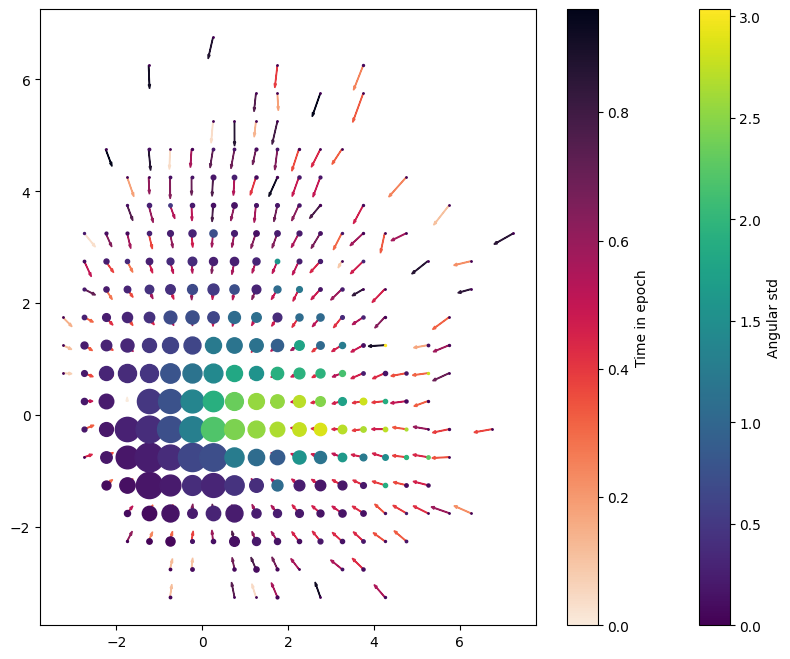

In [12]:
label = 'broader_label'
label = 'label'
keep_pc = len(var_names)
start, end, step = -15, 15, .5

# Save data of all sessions for latter
idxs = []
mouse_names = []
for m, mat in enumerate(design_matrices):
    
    mouse_name = design_matrices[m][51:-4]
    eid = design_matrices[m][14:50]
    idx = str(eid + '_' + mouse_name)
    if m == 0:
        idxs = idx
        mouse_names = mouse_name
    else:
        idxs = np.hstack((idxs, idx))
        mouse_names = np.hstack((mouse_names, mouse_name))
            
            
cross_stats = pd.DataFrame(columns=['var', 'epoch', 'hue', 'difference', 'p_value', 'idx'])
for m, mat in enumerate(idxs[0:1]):
    if len(mat) > 35: 
        
        # Trials data
        session = mat[0:36]
        # Mouse name
        mouse_name = mat[37:]
        
        print('Mouse ' + mouse_name)

        # Get mouse data
        session_trials = session_all[mouse_name][session]
        design_matrix = matrix_all[mouse_name][session]
        unnorm_mat = matrix_all_unnorm[mouse_name][session]
        epoch_matrix = epoch_df[mouse_name][session]
        
        if len(np.shape(design_matrix)) > 2:
            design_matrix = design_matrix[0]
            session_trials = session_trials[0]
            unnorm_mat = matrix_all_unnorm[mouse_name][0]
            # epoch =  epoch_df[mouse_name][session] = new_df
            
        # Run PCA on data
        X_reduced, X = pca_behavior(epoch_matrix[var_names], keep_pc, plot=False)
        augmented = augment_data(X_reduced, epoch_matrix, keep_pc)
        
        # Augment data
        augmented_data = augmented.copy()
        
        # Count bins per trial epoch
        augmented_data['dif_trial'] = augmented_data['Trial']
        augmented_data['dif_trial'][1:] = np.diff(augmented_data['Trial'])
        augmented_data['Count'] = augmented_data['Trial'] *  0
        augmented_data['Count'] = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum()).cumcount() + 1
        # Find the maximum value before resetting for each group
        max_values = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum())['Count'].transform('max')
        # Normalize the count by the maximum value before resetting
        augmented_data['Normalized_count'] = augmented_data['Count'] / max_values

        fig, ax = plt.subplots(figsize=[10, 8])
        plot_flow_field(start, end, step, augmented_data)


## Plot interpolated trial trajectories

Mouse SWC_052


/tmp/ipykernel_9959/368269895.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/368269895.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/368269895.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/368269895.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/368269895.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.conca

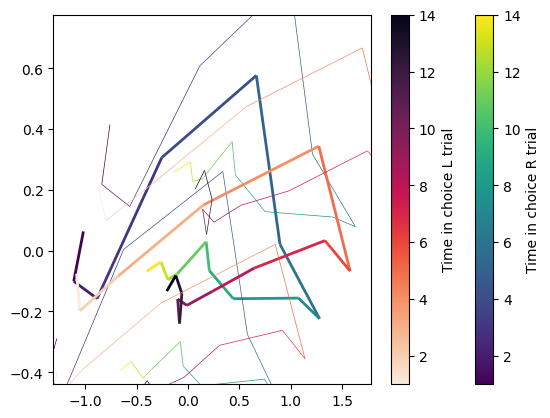

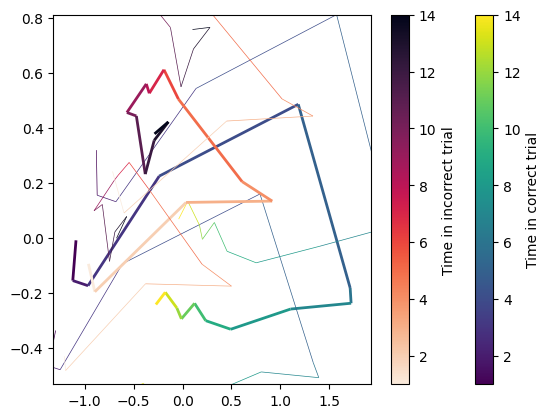

In [19]:
label = 'broader_label'
label = 'label'
keep_pc = len(var_names)
window_size = 15

# Save data of all sessions for latter
idxs = []
mouse_names = []
for m, mat in enumerate(design_matrices):
    
    mouse_name = design_matrices[m][51:-4]
    eid = design_matrices[m][14:50]
    idx = str(eid + '_' + mouse_name)
    if m == 0:
        idxs = idx
        mouse_names = mouse_name
    else:
        idxs = np.hstack((idxs, idx))
        mouse_names = np.hstack((mouse_names, mouse_name))
            
            
cross_stats = pd.DataFrame(columns=['var', 'epoch', 'hue', 'difference', 'p_value', 'idx'])
for m, mat in enumerate(idxs[0:1]):
    if len(mat) > 35: 
        
        # Trials data
        session = mat[0:36]
        # Mouse name
        mouse_name = mat[37:]
        
        print('Mouse ' + mouse_name)

        # Get mouse data
        session_trials = session_all[mouse_name][session]
        design_matrix = matrix_all[mouse_name][session]
        unnorm_mat = matrix_all_unnorm[mouse_name][session]
        epoch_matrix = epoch_df[mouse_name][session]
        
        if len(np.shape(design_matrix)) > 2:
            design_matrix = design_matrix[0]
            session_trials = session_trials[0]
            unnorm_mat = matrix_all_unnorm[mouse_name][0]
            # epoch =  epoch_df[mouse_name][session] = new_df
            
        # Run PCA on data
        X_reduced, X = pca_behavior(epoch_matrix[var_names], keep_pc, plot=False)
        augmented = augment_data(X_reduced, epoch_matrix, keep_pc)
        
        try:
            # Interpolate trials in PC space
            plot_trajectories_hue (augmented, window_size)
        except:
            print(mat)

/tmp/ipykernel_9959/41591087.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/41591087.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/41591087.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/41591087.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trial_info = trial_info.append(meta)
/tmp/ipykernel_9959/41591087.py:234: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat ins

(-2.0, 4.0)

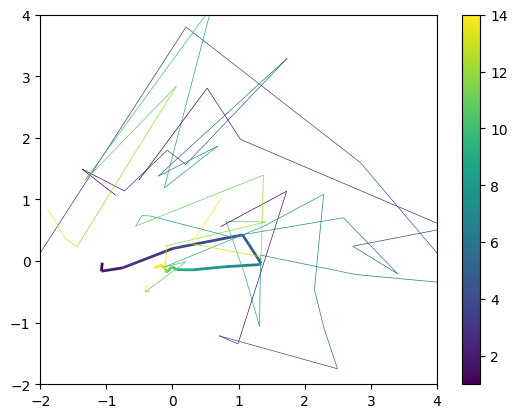

In [15]:
# Interpolate trials in PC space
inter_pc1, inter_pc2, trial_info = stack_interpolated(augmented, window_size)
time = np.arange(1, window_size, 1)
fig, axs = plt.subplots()
trial_num = len(trial_info)
trial_num = 5
for t, trial in enumerate(range(trial_num)):
    if t == 0:
        x = np.mean(inter_pc1, axis=0)
        y = np.mean(inter_pc2, axis=0)

        # Create a set of line segments so that we can color them individually
        # This creates the points as an N x 1 x 2 array so that we can stack points
        # together easily to get the segments. The segments array for line collection
        # needs to be (numlines) x (points per line) x 2 (for x and y)
        points = np.array([x, y]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)

        # Create a continuous norm to map from data points to colors
        norm = plt.Normalize(time.min(), time.max())
        lc = LineCollection(segments, cmap='viridis', norm=norm)
        # Set the values used for colormapping
        lc.set_array(time)
        lc.set_linewidth(2)
        line = axs.add_collection(lc)

    else:
        x = inter_pc1[t, :]
        y = inter_pc2[t, :]
        
        # Create a set of line segments so that we can color them individually
        # This creates the points as an N x 1 x 2 array so that we can stack points
        # together easily to get the segments. The segments array for line collection
        # needs to be (numlines) x (points per line) x 2 (for x and y)
        points = np.array([x, y]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)

        # Create a continuous norm to map from data points to colors
        norm = plt.Normalize(time.min(), time.max())
        lc = LineCollection(segments, cmap='viridis', norm=norm)
        # Set the values used for colormapping
        lc.set_array(time)
        lc.set_linewidth(.5)
        line = axs.add_collection(lc)
fig.colorbar(line, ax=axs)
plt.xlim([-2, 4])
plt.ylim([-2, 4])


In [176]:
# TODO: need to improve this code to make it versatile
# Remap labels
augmented[label] = augmented[label].replace({'Stimulus left':'Simulus', 
        'Stimulus right':'Stimulus', 'Correct feedback':'ITI', 
        'Incorrect feedback':'ITI',
        'ITI_correct':'ITI', 'ITI_incorrect':'ITI'})
trial_epochs = ['Quiescence', 'Stimulus',
        'Left choice', 'Right choice', 'ITI']
# plot_per_epoch(augmented, trial_epochs)
def plot_per_epoch(augmented, trial_epochs):
    colors = sns.color_palette('viridis', len(trial_epochs))
    for e, epoch in enumerate(trial_epochs): 
        augmented_data = augmented.loc[augmented[label]==epoch].reset_index()
        # Count bins per trial epoch
        augmented_data['dif_trial'] = augmented_data['Trial']
        augmented_data['dif_trial'][1:] = np.diff(augmented_data['Trial'])
        augmented_data['Count'] = augmented_data['Trial'] *  0
        augmented_data['Count'] = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum()).cumcount() + 1
        # Find the maximum value before resetting for each group
        max_values = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum())['Count'].transform('max')
        # Normalize the count by the maximum value before resetting
        augmented_data['Normalized_count'] = augmented_data['Count'] / max_values
        
        color = colors[e]
        legend_name = epoch
        fig, ax = plt.subplots(figsize=[10, 8])
        plot_flow_field(start, end, step, augmented_data, colors[e], legend_name)
        plt.title(legend_name)
        # plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))
        plt.xlim([-4, 4.5])
        plt.ylim([-4, 12.5])



## PCA

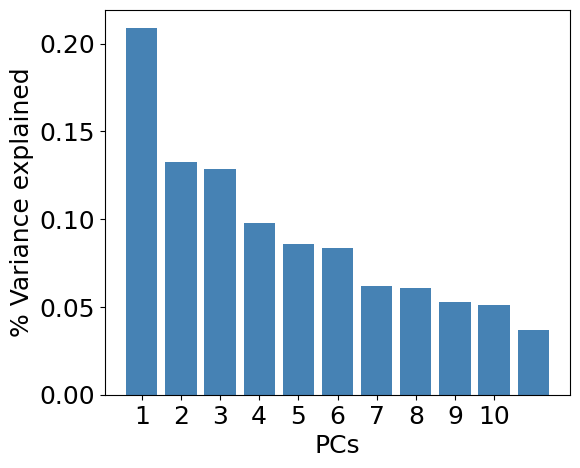

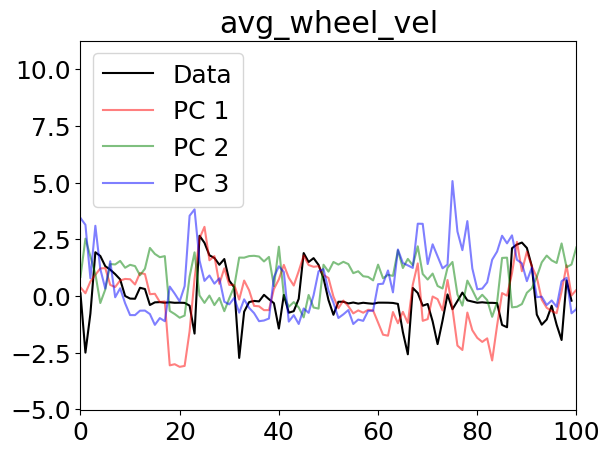

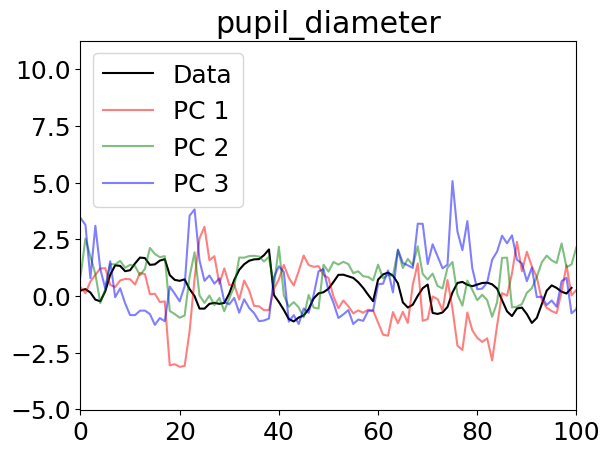

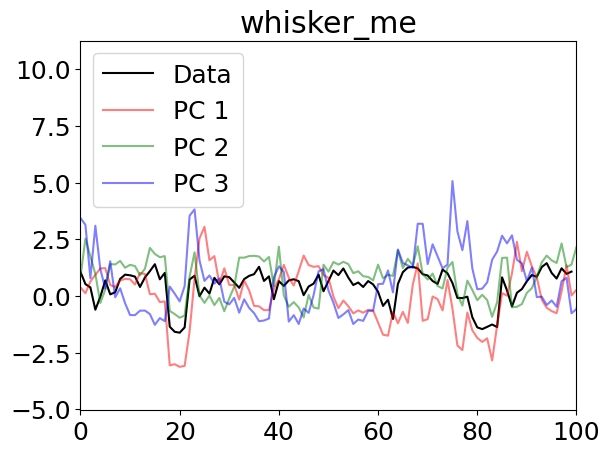

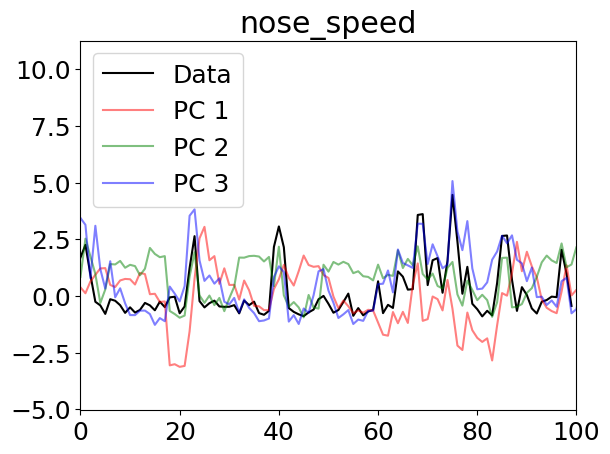

...

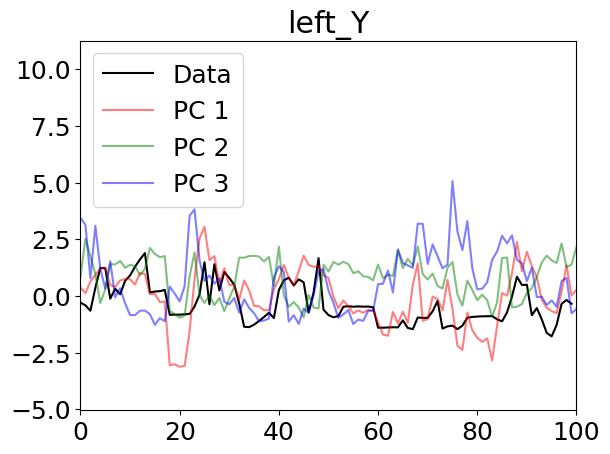

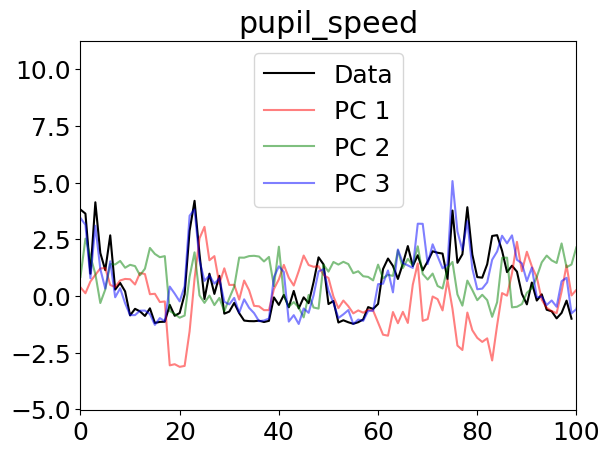

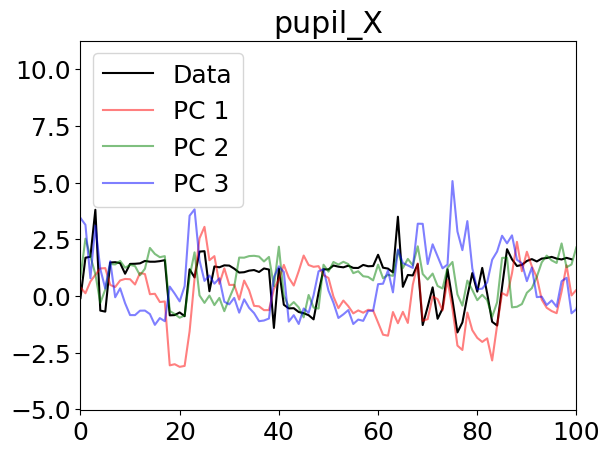

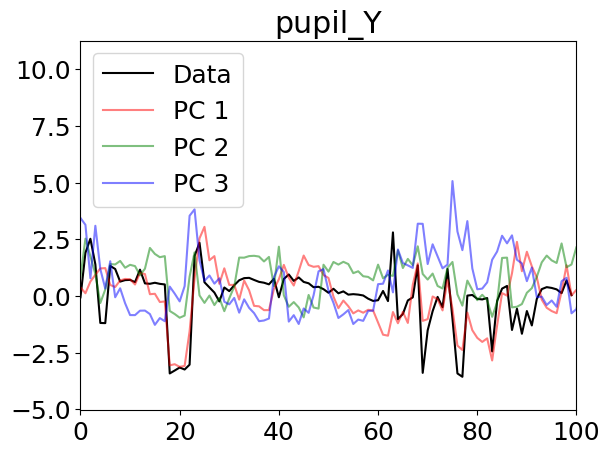

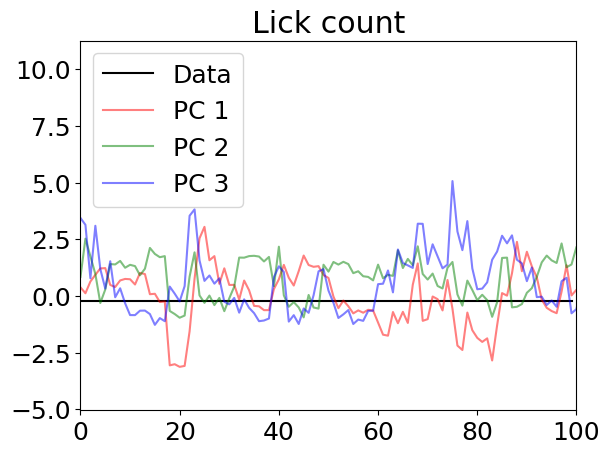

In [170]:
keep_pc = len(var_names)
# keep_pc =3
label = 'broader_label'
label = 'label'

X_reduced, X = pca_behavior(epoch_matrix[var_names], keep_pc, plot=False)
augmented = augment_data(X_reduced, epoch_matrix, keep_pc)
plot_timeseries_pcs(X, augmented, var_names, 0, 100)

## UMAP

In [10]:
umap.UMAP(a=None, angular_rp_forest=False, b=None,
     force_approximation_algorithm=False, init='spectral', learning_rate=1.0,
     local_connectivity=1.0, low_memory=False, metric='euclidean',
     metric_kwds=None, min_dist=0.1, n_components=2, n_epochs=None,
     n_neighbors=15, negative_sample_rate=5, output_metric='euclidean',
     output_metric_kwds=None, random_state=42, repulsion_strength=1.0,
     set_op_mix_ratio=1.0, spread=1.0, target_metric='categorical',
     target_metric_kwds=None, target_n_neighbors=-1, target_weight=0.5,
     transform_queue_size=4.0, transform_seed=42, unique=False, verbose=False)

NameError: name 'UMAP' is not defined

In [11]:
keep_pc = 2
reducer = umap.UMAP(n_components=keep_pc)
embedding = reducer.fit_transform(X)
augmented = augment_data(embedding, epoch_matrix, keep_pc)
embedding.shape

(2424, 2)

/tmp/ipykernel_9959/1754127013.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  augmented_data['dif_trial'][1:] = np.diff(augmented_data['Trial'])
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/ines/miniconda3/envs/iblenv/lib/python3.9/site-packages/numpy/core/_methods.py:223: Run

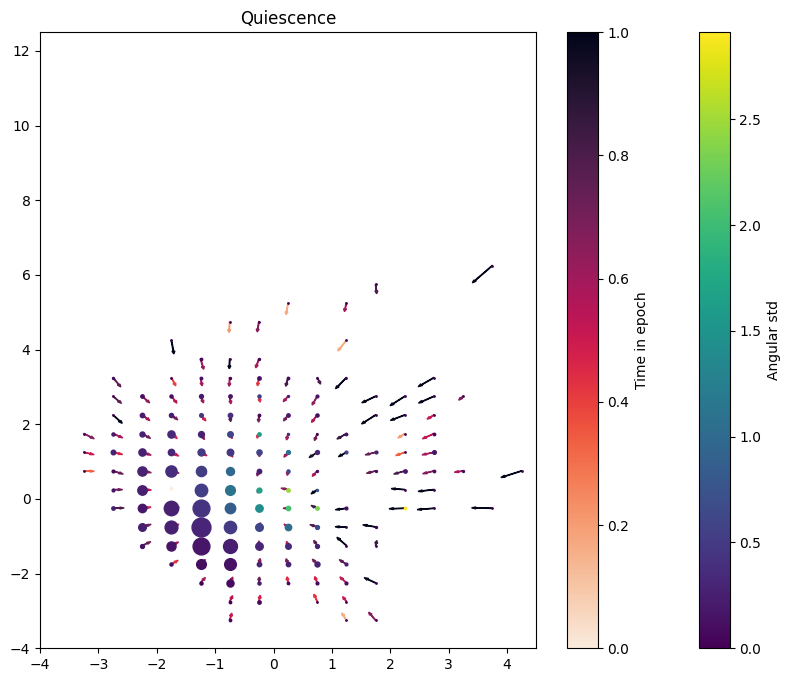

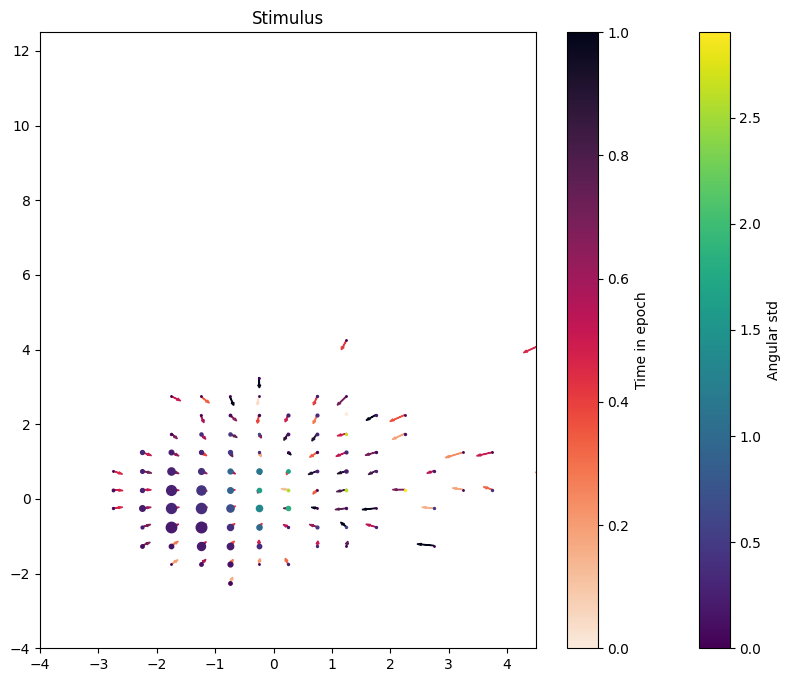

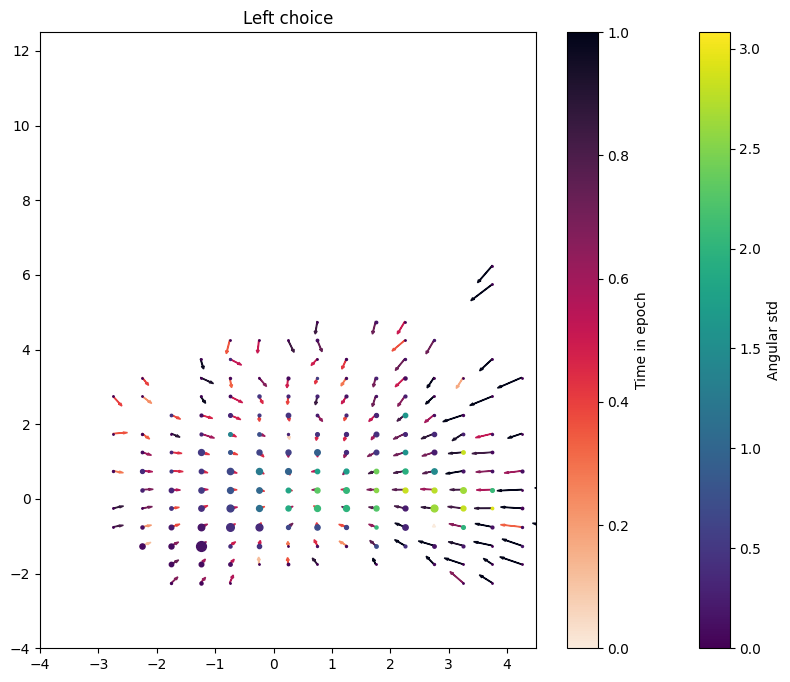

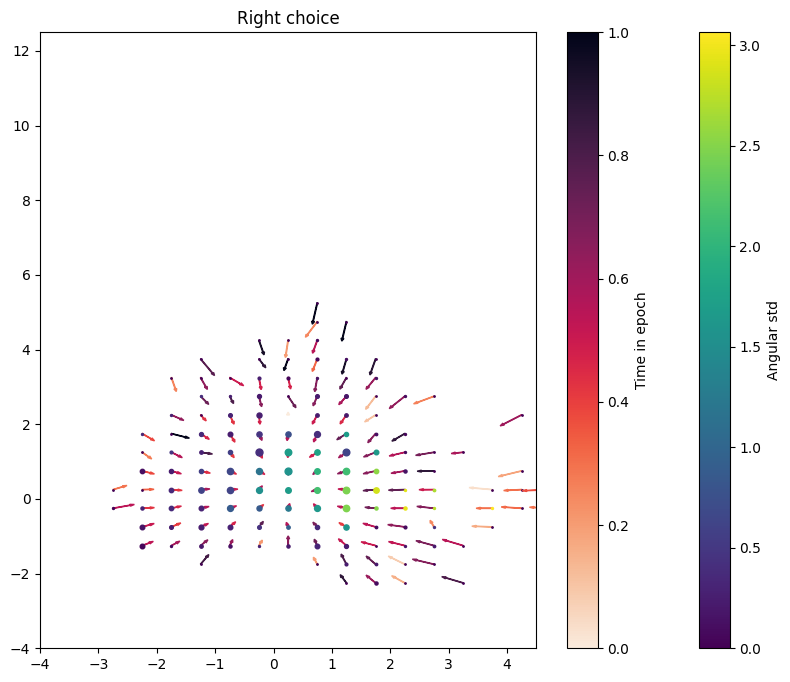

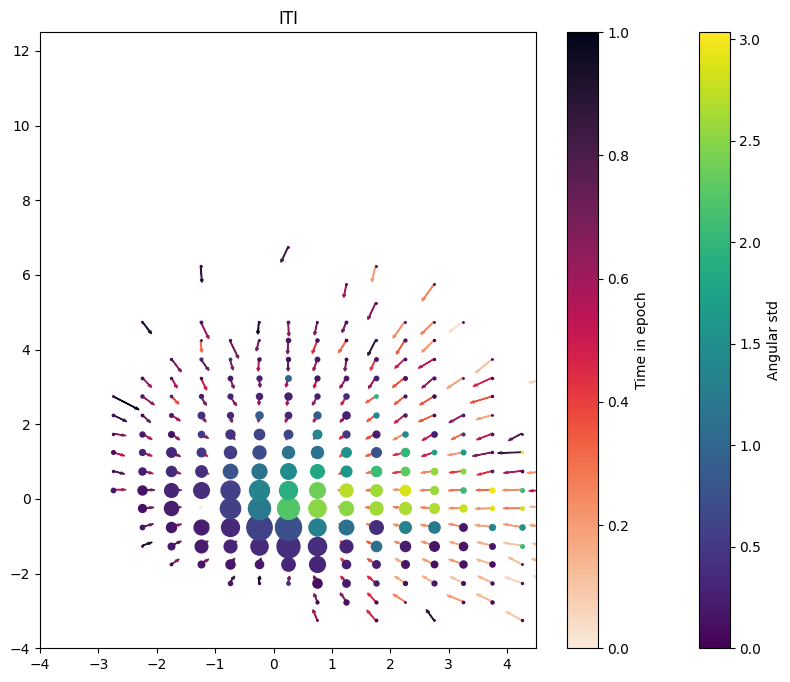

In [17]:
# Define the range and interval for grid
start, end, step = -15, 15, .5
label = 'broader_label'
label = 'label'
trial_epochs = ['Quiescence', 'Stimulus left', 
                'Stimulus right', 'Left choice',
                'Right choice', 'Correct feedback', 'Incorrect feedback',
                'ITI_correct', 'ITI_incorrect']
trial_epochs = ['Quiescence', 'Stimulus',
                'Left choice', 'Right choice', 'ITI']

augmented[label] = augmented[label].replace({'Stimulus left':'Simulus', 
                'Stimulus right':'Stimulus', 'Correct feedback':'ITI', 
                'Incorrect feedback':'ITI',
                'ITI_correct':'ITI', 'ITI_incorrect':'ITI'})


colors = sns.color_palette('viridis', len(trial_epochs))
for e, epoch in enumerate(trial_epochs): 
    augmented_data = augmented.loc[augmented[label]==epoch].reset_index()
    # Count bins per trial epoch
    augmented_data['dif_trial'] = augmented_data['Trial']
    augmented_data['dif_trial'][1:] = np.diff(augmented_data['Trial'])
    augmented_data['Count'] = augmented_data['Trial'] *  0
    augmented_data['Count'] = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum()).cumcount() + 1
    # Find the maximum value before resetting for each group
    max_values = augmented_data.groupby((augmented_data['dif_trial'] == 1).cumsum())['Count'].transform('max')
    # Normalize the count by the maximum value before resetting
    augmented_data['Normalized_count'] = augmented_data['Count'] / max_values
    
    color = colors[e]
    legend_name = epoch
    fig, ax = plt.subplots(figsize=[10, 8])
    plot_flow_field(start, end, step, augmented_data)
    plt.title(legend_name)
    # plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))
    plt.xlim([-4, 4.5])
    plt.ylim([-4, 12.5])

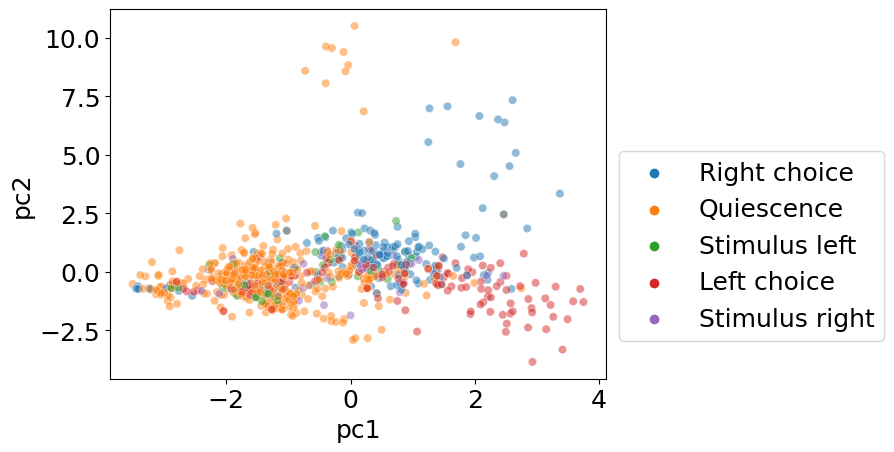

In [174]:
use_data = augmented.loc[augmented['label'].isin(['Right choice', 'Quiescence',
       'Stimulus left', 
       'Left choice', 'Stimulus right'])]
sns.scatterplot(x='pc1', y='pc2', hue='label', data=use_data, alpha=0.5)
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.65))
# plt.ylim([-3, 3])

/tmp/ipykernel_10068/2595119688.py:5: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  mean_label = pd.DataFrame(data.groupby(['label', 'Trial'])['pc1', 'pc2'].mean())
/tmp/ipykernel_10068/2595119688.py:25: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  mean_trial = pd.DataFrame(data.groupby([label, 'Trial'])['pc1', 'pc2'].mean())
/tmp/ipykernel_10068/2595119688.py:29: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  correct_left_data_mean = pd.DataFrame(correct_left_data.groupby([label])['pc1', 'pc2'].mean())
/tmp/ipykernel_10068/2595119688.py:31: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  incorrect_left_data_mean = pd.DataFrame(incorrect_left_data.groupby([label])['pc1'

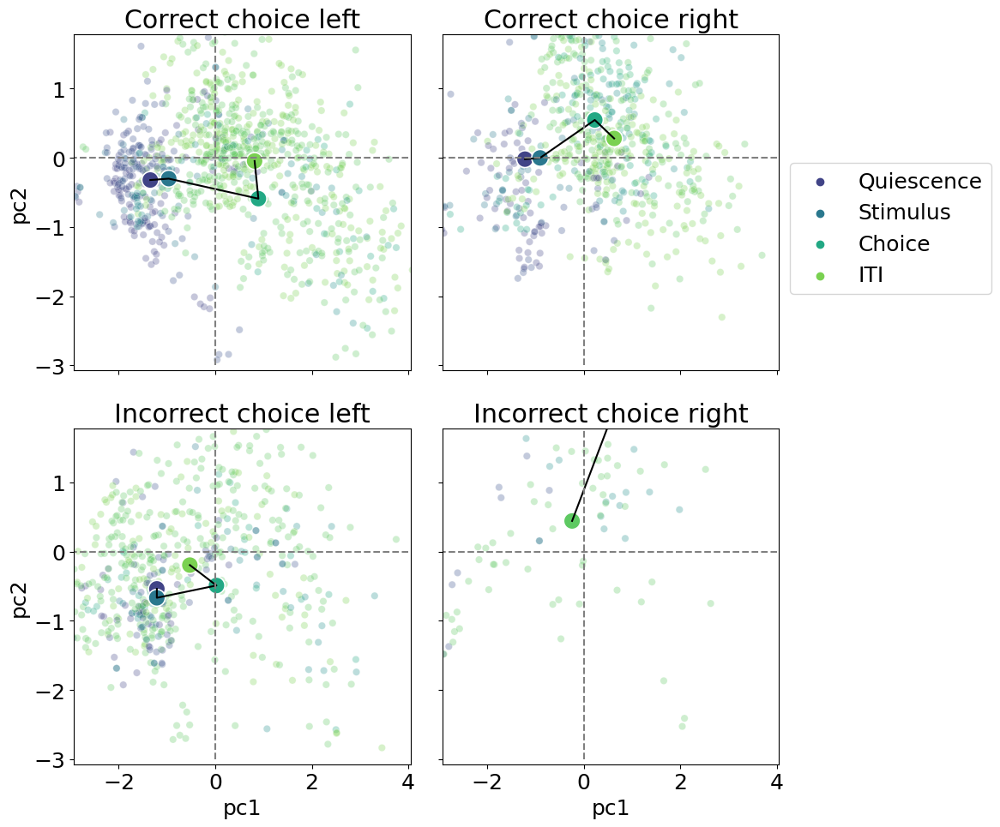

In [37]:
plot_trial_epoch(augmented_data, label)

In [38]:
# TODO: need to edit
trials = augmented['Trial'].unique()
label = 'broader_label'

fig, axs = plt.subplots(nrows=1 , ncols=2, sharex=True, sharey=True, figsize=[10, 5])

for t, trial in enumerate(trials):

    use_data = augmented.loc[augmented['Trial']==trial]
    trial_data_pc1 = augmented.loc[augmented['Trial']==trial, 'pc1']
    trial_data_pc2 = augmented.loc[augmented['Trial']==trial, 'pc2']
    
    if ('Correct feedback' in np.array(use_data['label'])) & ('Left choice' in np.array(use_data['label'])):
        sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[0]) # s=200
        #axs[0, 0].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
    elif ('Correct feedback' in np.array(use_data['label'])) & ('Right choice' in np.array(use_data['label'])):
        sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[1]) # s=200
        #axs[0, 1].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
    elif ('Incorrect feedback' in np.array(use_data['label'])) & ('Left choice' in np.array(use_data['label'])):
        sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[0]) # s=200
        #axs[1, 0].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
    elif ('Incorrect feedback' in np.array(use_data['label'])) & ('Right choice' in np.array(use_data['label'])):
        sns.scatterplot(x='pc1', y='pc2', data=use_data, alpha=0.3, hue=label, palette='viridis', legend=None, ax=axs[1]) # s=200
        #axs[1, 1].plot(trial_data_pc1, trial_data_pc2, color='Gray', alpha=0.1) 
    
    axs[0].set_title('Choice left')
    axs[1].set_title('Choice right')

grouped, grouped_mean = group_per_phase(augmented, label)

correct_left_data = grouped[0]
incorrect_left_data = grouped[1]
correct_right_data = grouped[2]
incorrect_right_data = grouped[3]

correct_left_data_mean = grouped_mean[0]
incorrect_left_data_mean = grouped_mean[1]
correct_right_data_mean = grouped_mean[2]
incorrect_right_data_mean = grouped_mean[3]
    
axs[0].plot(np.array(correct_left_data_mean['pc1']), np.array(correct_left_data_mean['pc2']), color='Black') 
axs[1].plot(np.array(correct_right_data_mean['pc1']), np.array(correct_right_data_mean['pc2']), color='Black') 
axs[0].plot(np.array(incorrect_left_data_mean['pc1']), np.array(incorrect_left_data_mean['pc2']), color='Black') 
axs[1].plot(np.array(incorrect_right_data_mean['pc1']), np.array(incorrect_right_data_mean['pc2']), color='Black') 

sns.scatterplot(x='pc1', y='pc2', data=correct_left_data_mean, alpha=1, hue=label, legend=None, palette='viridis', ax=axs[0], s=200)
sns.scatterplot(x='pc1', y='pc2', data=correct_right_data_mean, alpha=1, hue=label, palette='viridis', ax=axs[1], s=200)
axs[1].legend(loc='upper left', bbox_to_anchor=(1, 0.65))
sns.scatterplot(x='pc1', y='pc2', data=incorrect_left_data_mean, alpha=1, hue=label, legend=None, 
                edgecolor='r', palette='viridis', ax=axs[0], s=200)
sns.scatterplot(x='pc1', y='pc2', data=incorrect_right_data_mean, alpha=1, hue=label, legend=None, 
                edgecolor='r', palette='viridis', ax=axs[1], s=200)

# Create grid
axs[0].vlines(0, -3, 4, color='Gray', linestyles='--')
axs[0].hlines(0, -3, 4, color='Gray', linestyles='--')
axs[1].vlines(0, -3, 4, color='Gray', linestyles='--')
axs[1].hlines(0, -3, 4, color='Gray', linestyles='--')

plt.tight_layout()
plt.show()


NameError: name 'augmented' is not defined